In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from glob import glob
import seaborn as sns

In [2]:
base_skin_dir = "C:/Users/Acer/Documents/skin cancer detection" #folder path
skin_df = pd.read_csv(os.path.join(base_skin_dir, "HAM10000_metadata.csv")) # load in the data #from kaggle
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear


In [83]:
imageid_path_dict = {os.path.splitext(os.path.basename(x))[0]: x
                     for x in glob(os.path.join(base_skin_dir, '*', '*.jpg'))}

lesion_type_dict = {
    'nv': 'Melanocytic_nevi',
    'mel': 'melanoma',
    'bkl': 'Benign_keratosis-like_lesions',
    'bcc': 'Basal_cell_carcinoma',
    'akiec': 'Actinic_keratoses',
    'vasc': 'Vascular_lesions',
    'df': 'Dermatofibroma'
}

lesion_danger = {
    'nv': 0, # 0 for benign
    'mel': 1, # 1 for malignant
    'bkl': 0, # 0 for benign
    'bcc': 1, # 1 for malignant
    'akiec': 1, # 1 for malignant
    'vasc': 0,
    'df': 0
}

In [84]:
skin_df["path"] = skin_df["image_id"].map(imageid_path_dict.get) # map image_id to the path of that image

In [85]:
skin_df["path"] = skin_df["image_id"].map(imageid_path_dict.get) # map image_id to the path of that image

In [86]:
skin_df["cell_type"] = skin_df["dx"].map(lesion_type_dict.get) # map dx to type of lesion

In [87]:
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,cell_type
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions


In [88]:
skin_df["Malignant"] = skin_df["dx"].map(lesion_danger.get)

In [89]:
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,cell_type,Malignant
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions,0
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions,0
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions,0
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions,0
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Benign_keratosis-like_lesions,0


In [90]:
skin_df["cell_type_idx"] = pd.Categorical(skin_df["cell_type"]).codes # give each cell type a category id

In [91]:
skin_df.sample(3)

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,cell_type,Malignant,cell_type_idx
5504,HAM_0001779,ISIC_0031439,nv,follow_up,65.0,male,upper extremity,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Melanocytic_nevi,0,4
3695,HAM_0006736,ISIC_0024492,nv,follow_up,60.0,male,lower extremity,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Melanocytic_nevi,0,4
7609,HAM_0004411,ISIC_0033376,nv,histo,55.0,male,back,C:/Users/Acer/Documents/COJAG/18 july 23\HAM10...,Melanocytic_nevi,0,4


<Axes: title={'center': 'Benign vs Malignant'}>

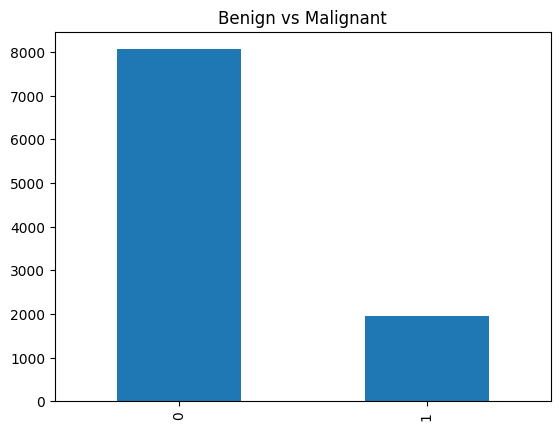

In [92]:
skin_df["Malignant"].value_counts().plot(kind="bar", title="Benign vs Malignant")

Most cases in our dataset are benign.

<Axes: title={'center': 'Counts for each type of Lesions'}>

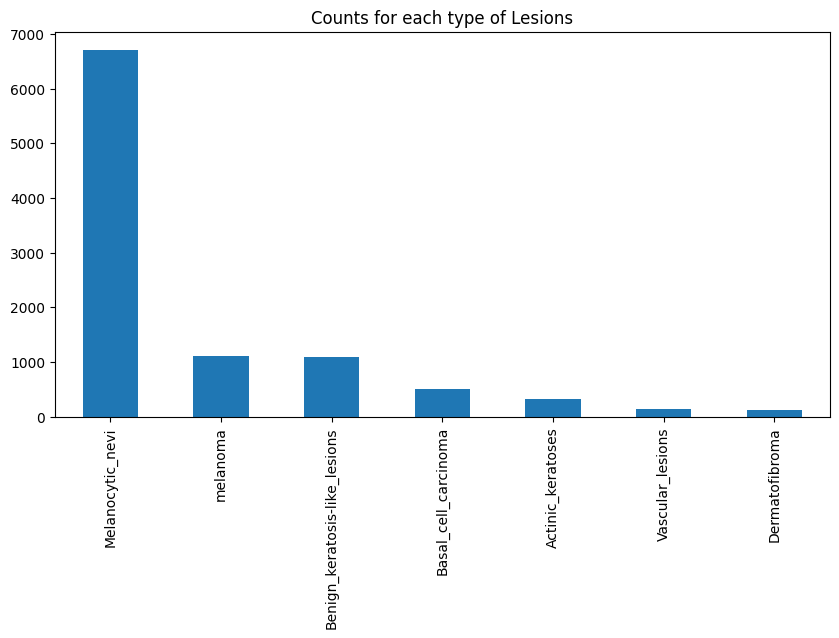

In [93]:
fig, ax1 = plt.subplots(1,1,figsize=(10,5))
skin_df["cell_type"].value_counts().plot(kind="bar", ax=ax1, title="Counts for each type of Lesions") # plot a graph counting the number of each cell type

Our dataset is biased toward Melanocytic nevi. The cell_type with the second highest samples is the noctorious melanoma

<Axes: title={'center': 'Location of Lesions'}>

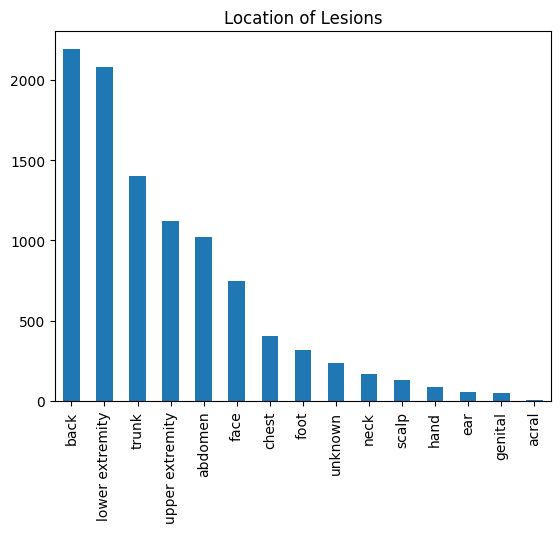

In [94]:
skin_df["localization"].value_counts().plot(kind='bar', title="Location of Lesions")

<Axes: title={'center': 'Treatment received'}>

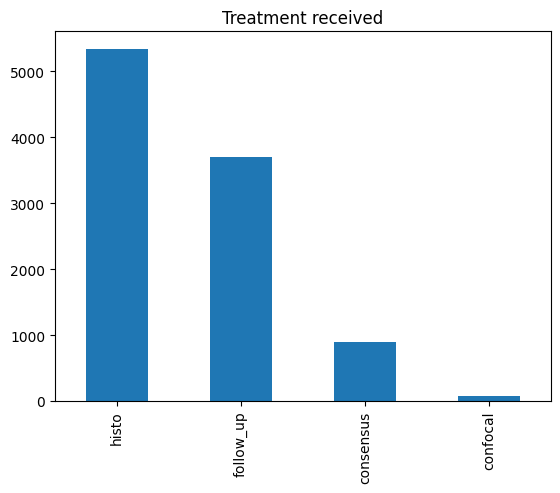

In [95]:
skin_df["dx_type"].value_counts().plot(kind='bar', title="Treatment received")

<Axes: >

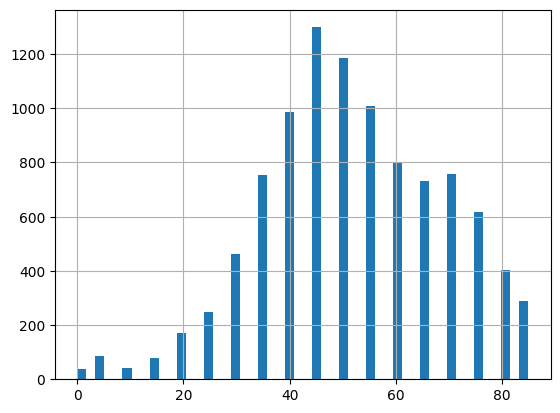

In [96]:
skin_df["age"].hist(bins=50)

<Axes: >

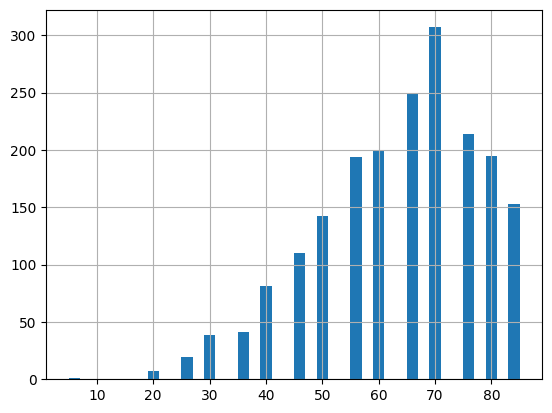

In [97]:
skin_df[skin_df["Malignant"] == 1]["age"].hist(bins=40)

We can see that most of patients are above 30. But for the malignant cases, most patients are 50 and above,  and 70s - year - old patients are the most present.

<Axes: title={'center': 'Male vs Female'}>

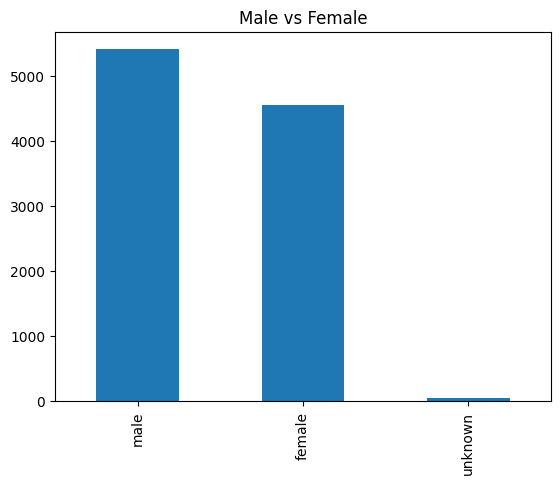

In [98]:
skin_df["sex"].value_counts().plot(kind="bar", title="Male vs Female")

<Axes: title={'center': 'Male vs Female. Malignant Cases'}>

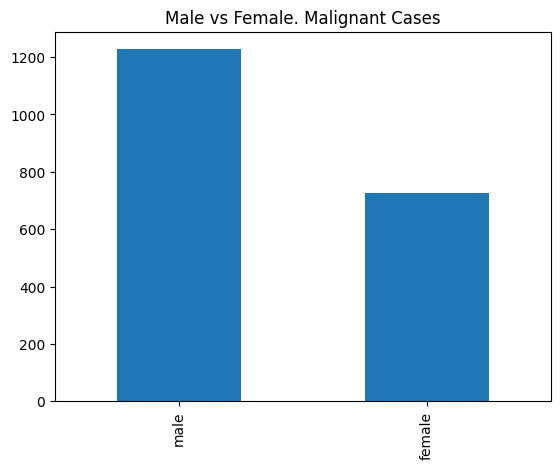

In [99]:
skin_df[skin_df["Malignant"] == 1]["sex"].value_counts().plot(kind="bar", title="Male vs Female. Malignant Cases")

We have more male patients than female patients in both general population and in malignant case. So far we haven't looked at our image yet. So let's now change our focus into how lesions in our dataset look like.

In [100]:
from skimage.io import imread

In [101]:
import pandas as pd

# Assuming skin_df is your DataFrame with "path" and "image" columns

# Remove rows with None values in the "path" column
skin_df = skin_df.dropna(subset=["path"])

# Now, proceed with reading the images using the corrected DataFrame
skin_df["image"] = skin_df["path"].map(imread)
 # read the image to array values

In [102]:
skin_df.iloc[0]["image"] # here is a sample

array([[[188, 147, 191],
        [186, 148, 189],
        [187, 150, 191],
        ...,
        [196, 155, 171],
        [197, 156, 170],
        [197, 157, 168]],

       [[186, 149, 193],
        [187, 152, 194],
        [189, 153, 191],
        ...,
        [194, 156, 169],
        [195, 159, 169],
        [192, 159, 168]],

       [[185, 148, 192],
        [189, 152, 195],
        [190, 153, 196],
        ...,
        [196, 155, 169],
        [198, 157, 171],
        [194, 156, 169]],

       ...,

       [[157, 124, 155],
        [156, 121, 154],
        [159, 124, 154],
        ...,
        [177, 146, 161],
        [176, 144, 159],
        [175, 141, 155]],

       [[155, 122, 151],
        [156, 123, 154],
        [156, 123, 152],
        ...,
        [178, 147, 163],
        [175, 144, 159],
        [175, 142, 159]],

       [[154, 119, 151],
        [153, 120, 149],
        [154, 121, 152],
        ...,
        [176, 147, 167],
        [175, 147, 161],
        [173, 143, 155]]

In [103]:
skin_df["image"].map(lambda x: x.shape).value_counts() 

(450, 600, 3)    10014
Name: image, dtype: int64

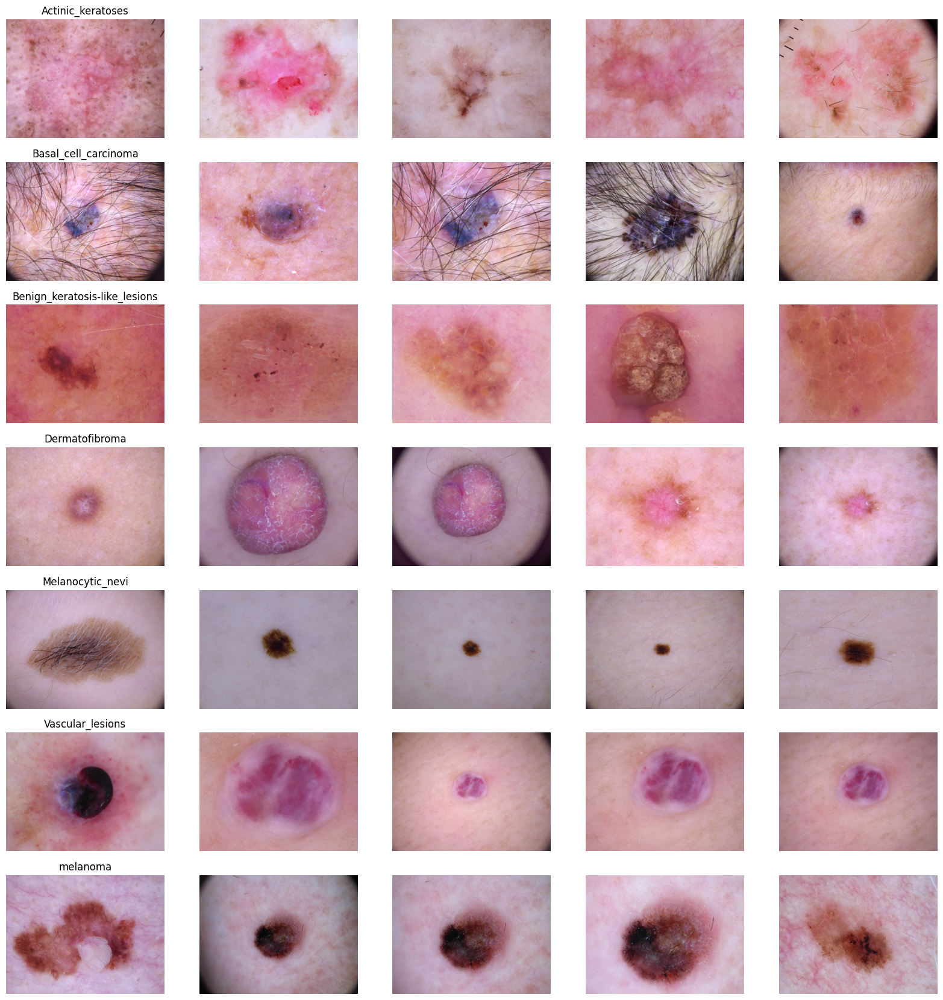

In [104]:
fig, m_axs = plt.subplots(7, n_samples, figsize=(4*n_samples, 3 * 7))

for n_axs, (type_name, type_rows) in zip(m_axs, skin_df.sort_values(["cell_type"]).groupby("cell_type")):
    n_axs[0].set_title(type_name)
    for i, (_, c_row) in enumerate(type_rows.iterrows()):
        if i >= n_samples:
            break
        n_axs[i].imshow(c_row["image"])
        n_axs[i].axis("off")
fig.savefig("category_samples.png", dpi=300)


In [109]:
# create a pandas dataframe to store mean value of Red, Blue and Green for each picture
rgb_info_df = skin_df.apply(lambda x: pd.Series({'{}_mean'.format(k): v for k, v 
                                                 in zip(["Red", "Blue", "Green"], 
                                                        np.mean(x["image"], (0, 1)))}), 1)


gray_col_vec = rgb_info_df.apply(lambda x: np.mean(x), 1) # take the mean value across columns of rgb_info_df
for c_col in rgb_info_df.columns:
    rgb_info_df[c_col] = rgb_info_df[c_col]/gray_col_vec 
rgb_info_df["Gray_mean"] = gray_col_vec
rgb_info_df.sample(3)

,Red_mean,Blue_mean,Green_mean,Gray_mean
8835,1.067646,0.924226,1.008127,172.923052
9919,1.140272,0.896049,0.963680,157.560521
7767,1.163304,0.933962,0.902734,140.581740


In [106]:
for c_col in rgb_info_df.columns:
    skin_df[c_col] = rgb_info_df[c_col].values

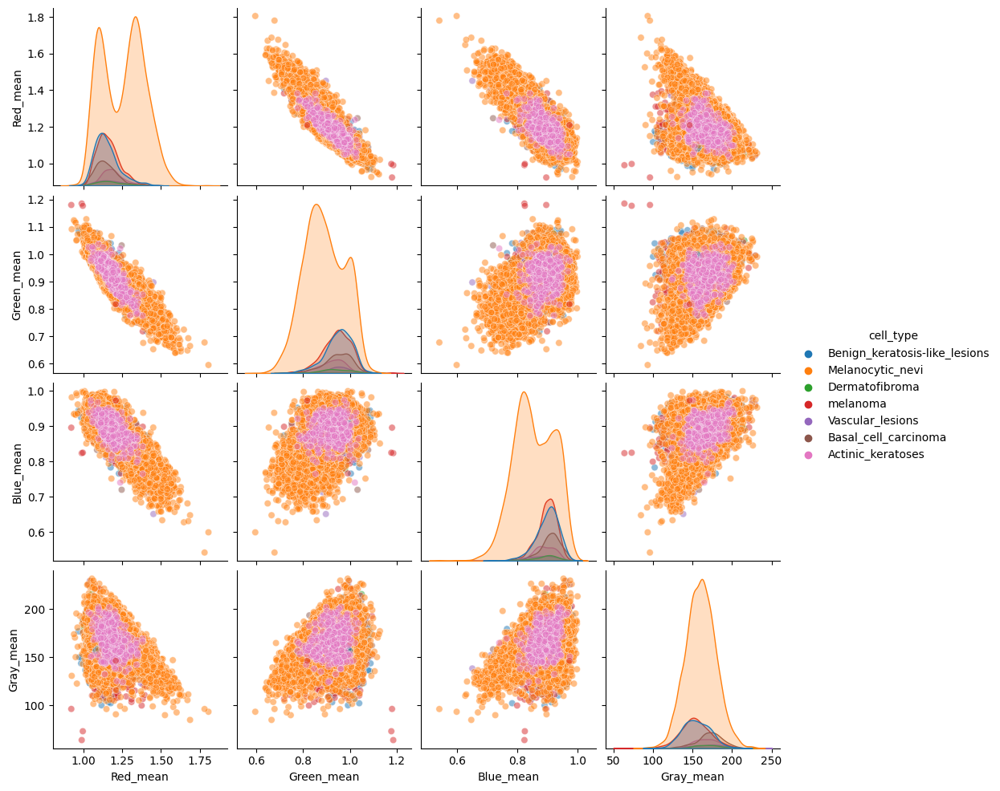

In [107]:
# let's draw a plot showing the distribution of different cell types over colors!
sns.pairplot(skin_df[["Red_mean", "Green_mean", "Blue_mean", "Gray_mean", "cell_type"]], 
             hue="cell_type", plot_kws = {"alpha": 0.5})

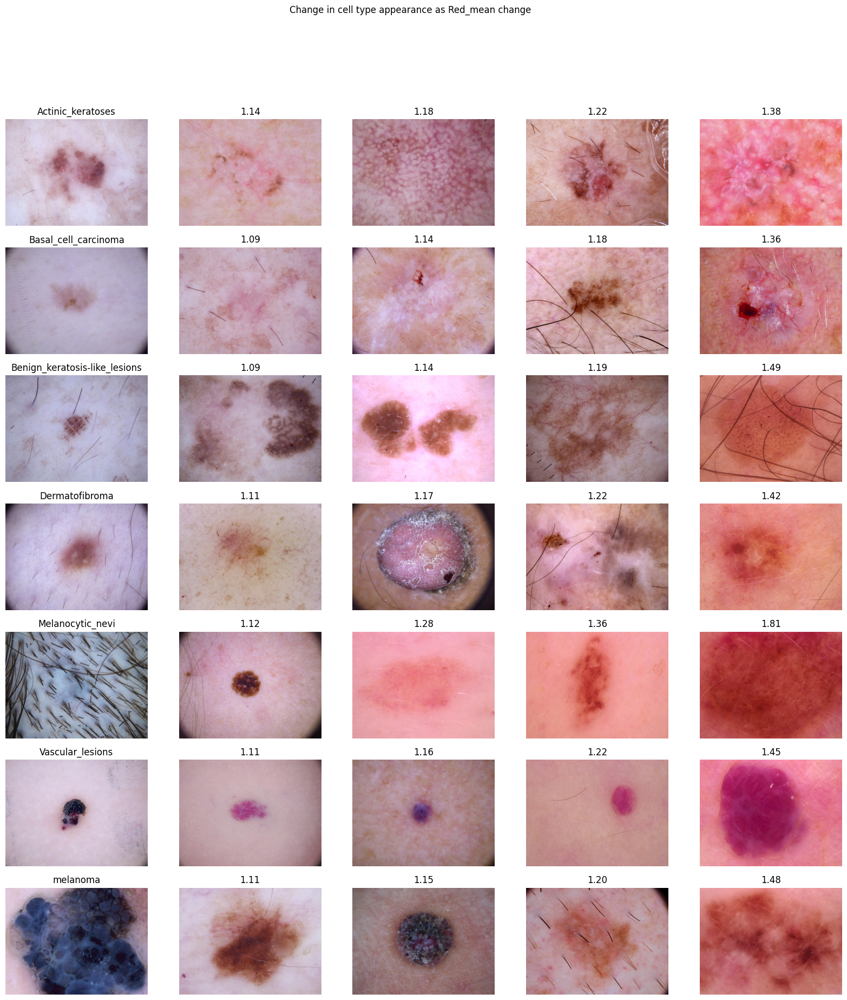

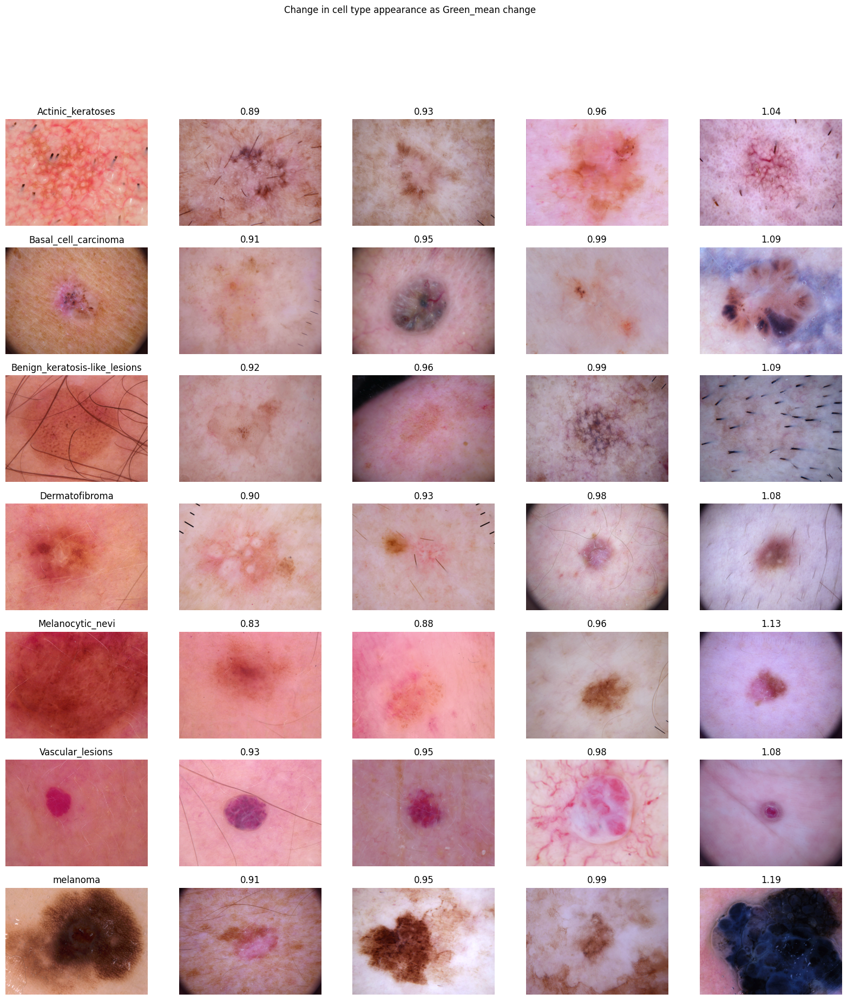

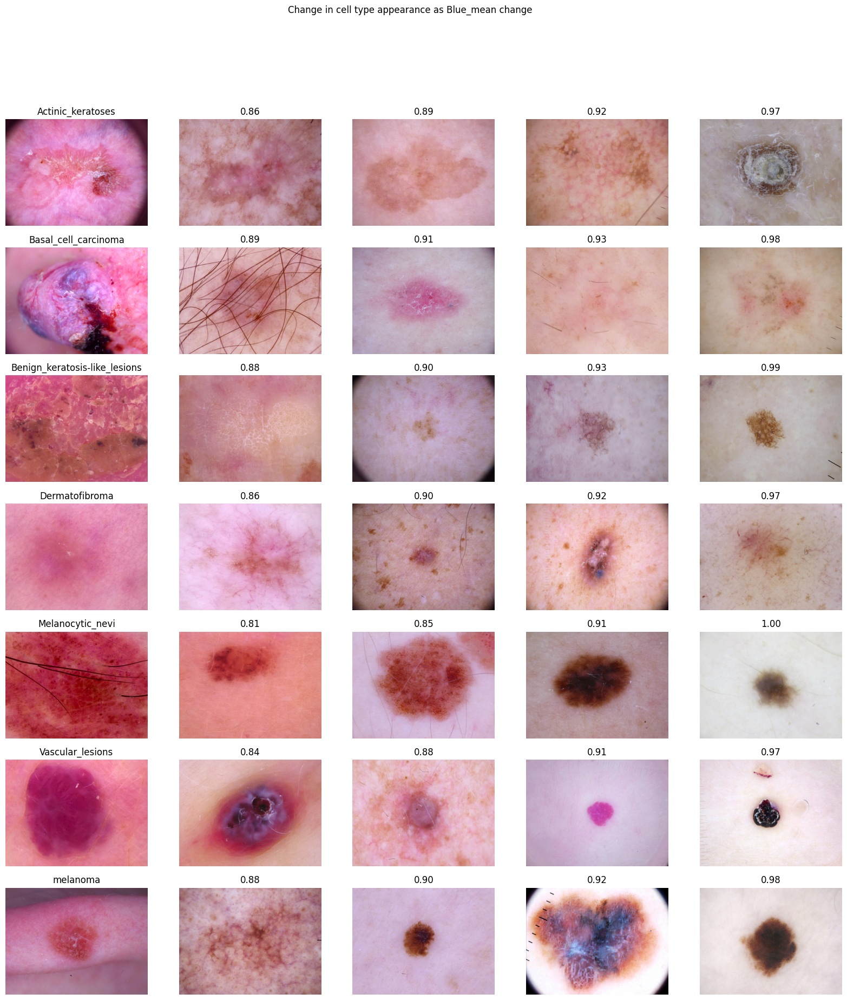

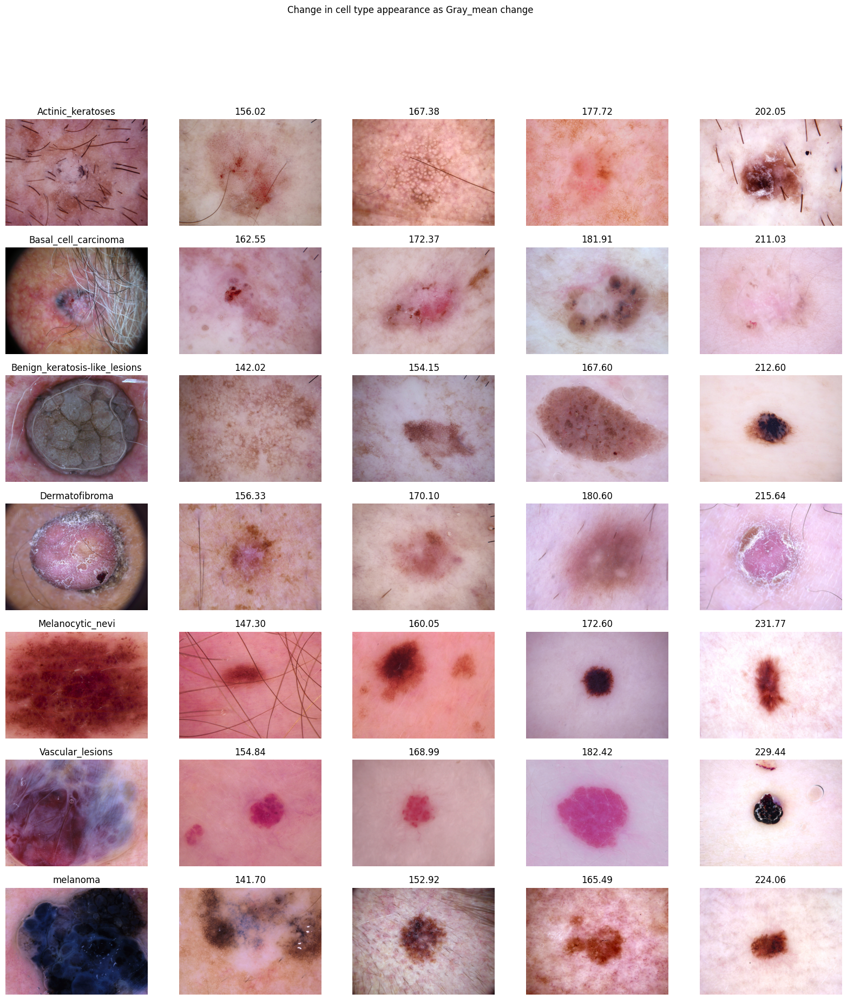

In [110]:
n_samples = 5
for sample_col in ["Red_mean", "Green_mean", "Blue_mean", "Gray_mean"]:
    fig, m_axs = plt.subplots(7, n_samples, figsize=(4 * n_samples, 3 * 7))
    fig.suptitle(f"Change in cell type appearance as {sample_col} change")
    # define a function to get back a dataframe with 5 samples sorted by color channel values 
    def take_n_space(in_rows, val_col, n):
        s_rows = in_rows.sort_values([val_col])
        s_idx = np.linspace(0, s_rows.shape[0] - 1, n, dtype=int)
        return s_rows.iloc[s_idx]
    
    for n_axs, (type_name, type_rows) in zip(m_axs, skin_df.sort_values(["cell_type"]).groupby("cell_type")):
        for c_ax, (_, c_row) in zip(n_axs, take_n_space(type_rows, sample_col, n_samples).iterrows()):
            c_ax.imshow(c_row["image"])
            c_ax.axis("off")
            c_ax.set_title('{:2.2f}'.format(c_row[sample_col]))
        n_axs[0].set_title(type_name)
    fig.savefig("{}_samples.png".format(sample_col), dpi=300)